First round of manual labeling using roboflow's labeling tool: https://roboflow.com

We manually labeled our smaller collected dataset (From week 1-2) in roboflow and exported the dataset in yolov8 format.

In [ ]:
!pip install ultralytics
!pip install supervision==0.24.0
!pip install PyYAML

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 978.8/978.8 kB 55.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 99.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 63.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 43.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 108.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninst

In [ ]:
!cp -r "/content/drive/MyDrive/Walmart_AI_Project/roboflow_dataset" "/content/"

Retrieve class names from the dataset data.yaml file

In [ ]:
import yaml
import os

yaml_file_path = '/content/roboflow_dataset/data.yaml'

class_names = []


# Open and read the YAML file
with open(yaml_file_path, 'r') as stream:
    data_yaml = yaml.safe_load(stream)

    # Check if loading was successful and it's a dictionary
    if isinstance(data_yaml, dict):
        # Access the list associated with the 'names' key
        extracted_names = data_yaml.get('names')

        if extracted_names is None:
            print(f"Error: 'names' key not found in '{yaml_file_path}'")
        elif not isinstance(extracted_names, list):
              print(f"Error: Value associated with 'names' key in '{yaml_file_path}' is not a list (found type: {type(extracted_names)}).")
        else:
            class_names = extracted_names # Assign the extracted list
            print(f"Successfully extracted {len(class_names)} class names from '{yaml_file_path}'.")

    else:
          print(f"Error: Content of '{yaml_file_path}' is not a valid YAML dictionary (parsed as type: {type(data_yaml)}).")

print("\nExtracted Class Names List:")
print(class_names)

# Print names with their corresponding index (class ID)
if class_names:
    print("\nClass Names with IDs:")
    for idx, name in enumerate(class_names):
        print(f"  ID {idx}: {name}")
else:
    print("\nCould not extract class names.")

Successfully extracted 7 class names from '/content/roboflow_dataset/data.yaml'.

Extracted Class Names List:
['APPLES', 'AVOCADOS', 'LEMONS', 'LIMES', 'ORANGE_PEPPER', 'RED_PEPPER', 'TOMATOES']

Class Names with IDs:
  ID 0: APPLES
  ID 1: AVOCADOS
  ID 2: LEMONS
  ID 3: LIMES
  ID 4: ORANGE_PEPPER
  ID 5: RED_PEPPER
  ID 6: TOMATOES


Run baseline test on testing set with un-fine tuned model

In [ ]:
# Untrained model test
test_images = "/content/roboflow_dataset/test/images"
# Evaluate on test images
!yolo predict \
  model=yolov8s.pt \
  source="{test_images}" \
  save=True \
  device=0 \
  name="roboflow_dataset_yolov8s_pre-train_predictions"
  # conf=0.4 # Conf threshold

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 21.5M/21.5M [00:00<00:00, 377MB/s]
Ultralytics 8.3.111 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
YOLOv8s summary (fused): 72 layers, 11,156,544 parameters, 0 gradients, 28.6 GFLOPs

image 1/10 /content/roboflow_dataset/test/images/LIME_SILVER_EZ_2_jpg.rf.ceef3940a23cc00aa302ce75a08015d9.jpg: 480x640 (no detections), 62.7ms
image 2/10 /content/roboflow_dataset/test/images/LIME_SILVER_MD_9_jpg.rf.4360d6d8be9f0094227f2d2ec678c061.jpg: 480x640 1 bowl, 7.8ms
image 3/10 /content/roboflow_dataset/test/images/PEPPER_EZ_1_jpg.rf.13e1109dff6f9c4b7fae62f044159cfc.jpg: 640x480 1 bottle, 1 vase, 69.0ms
image 4/10 /content/roboflow_dataset/test/images/PEPPER_MD_3_jpg.

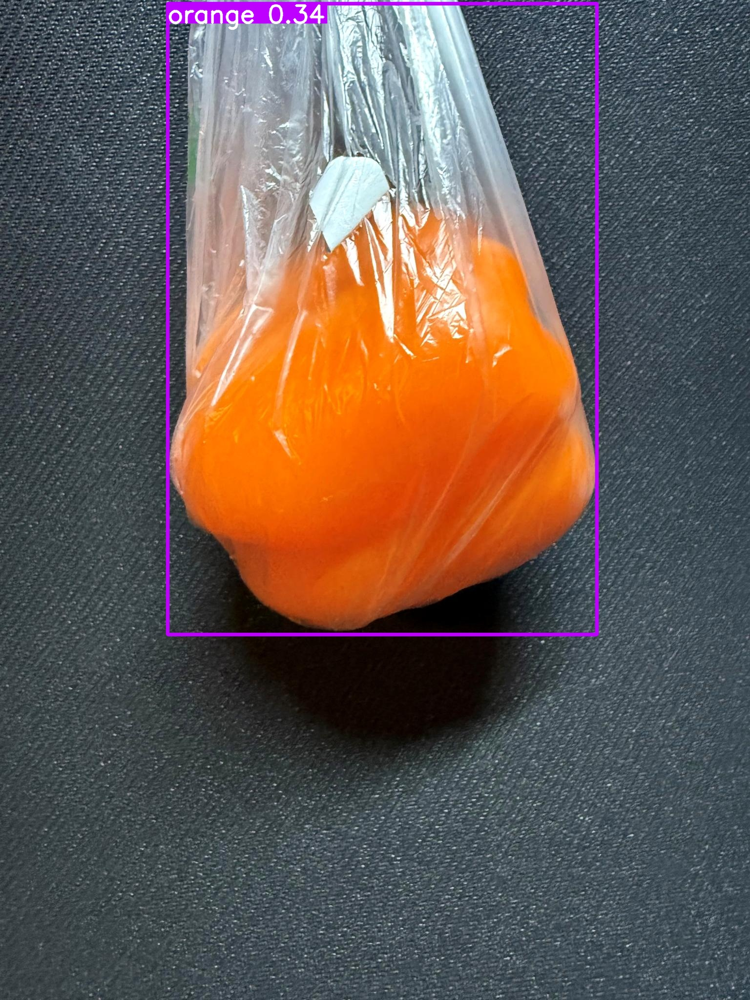

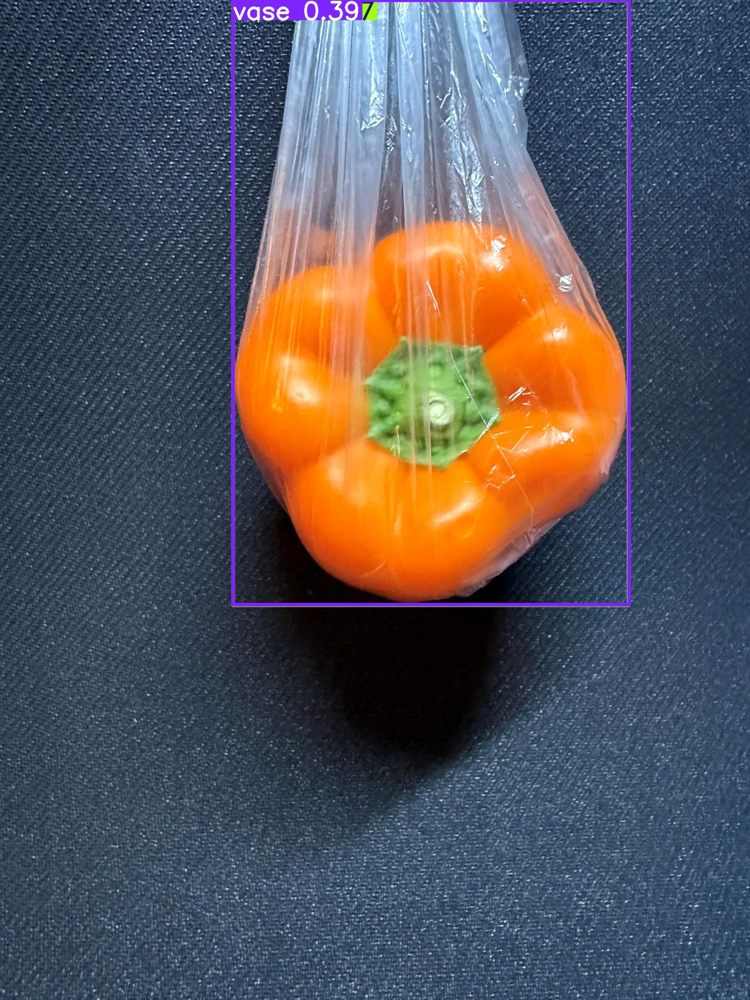

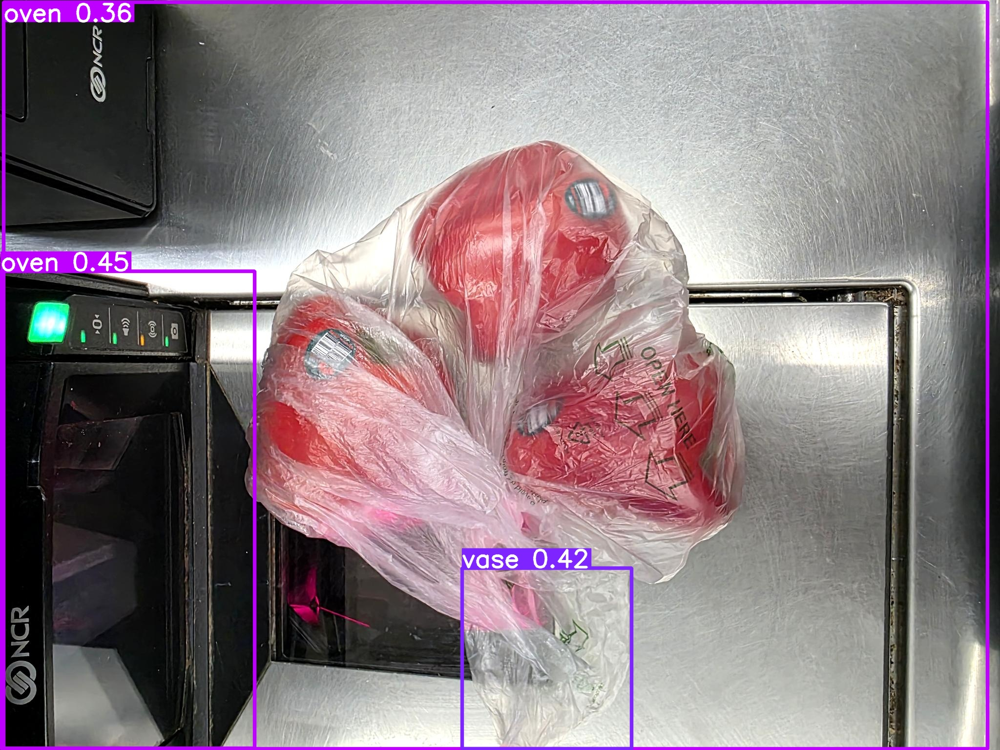

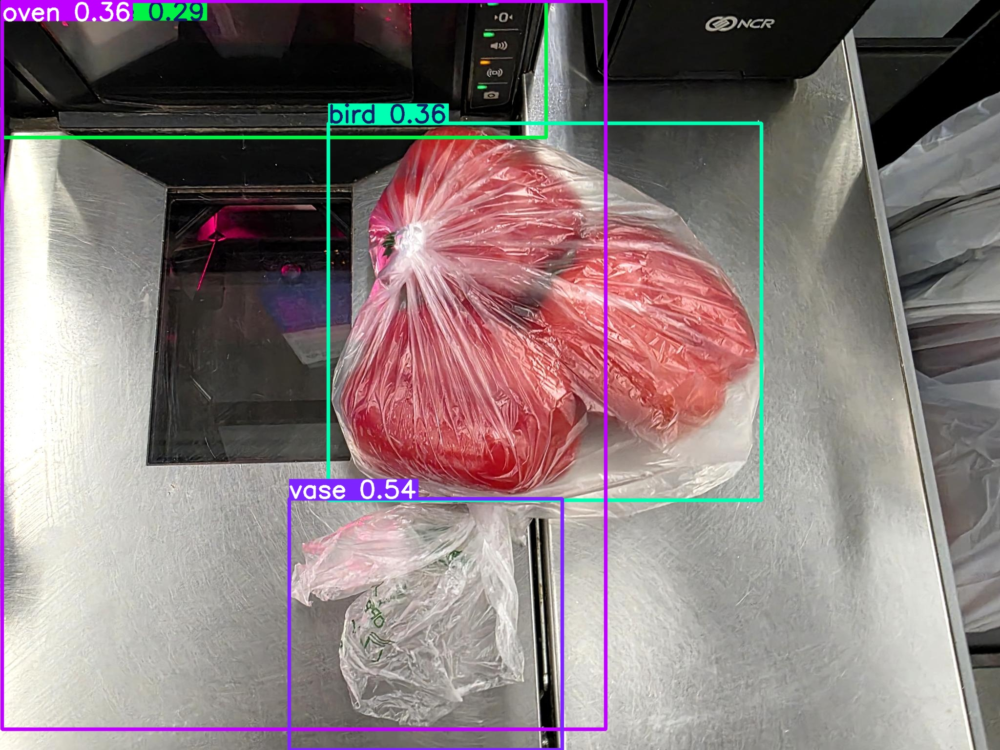

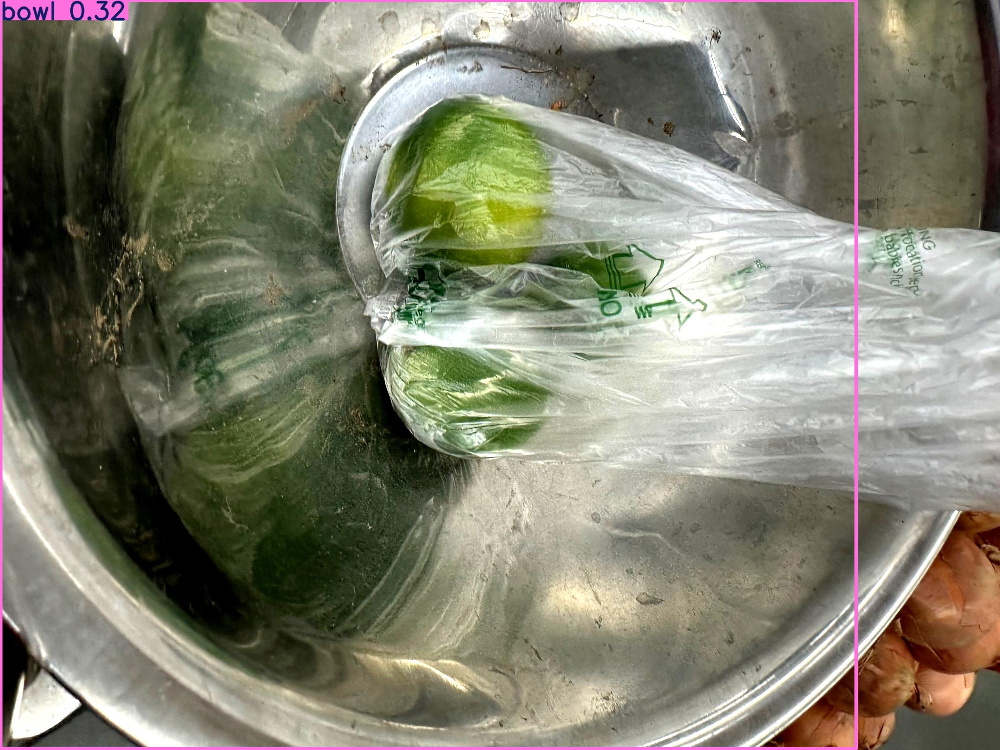

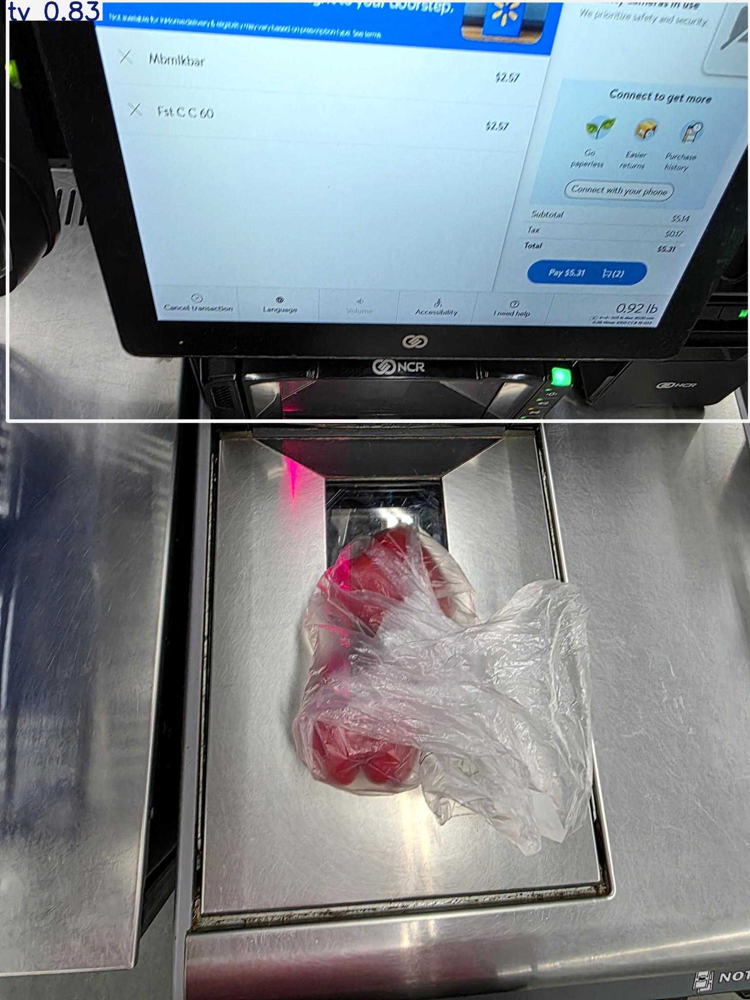

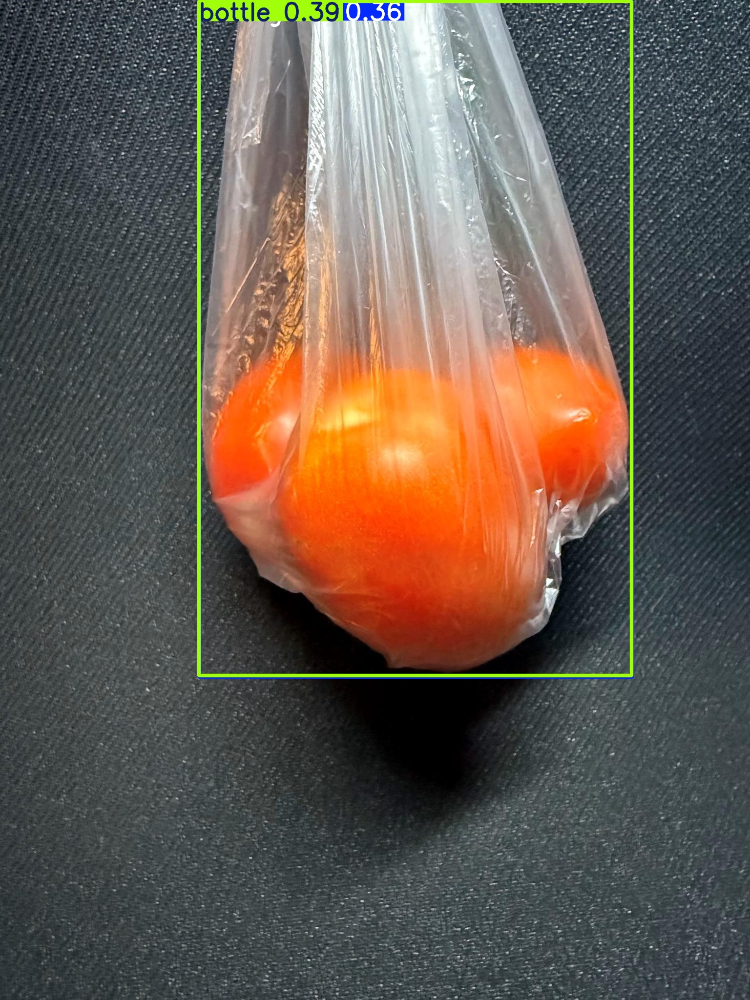

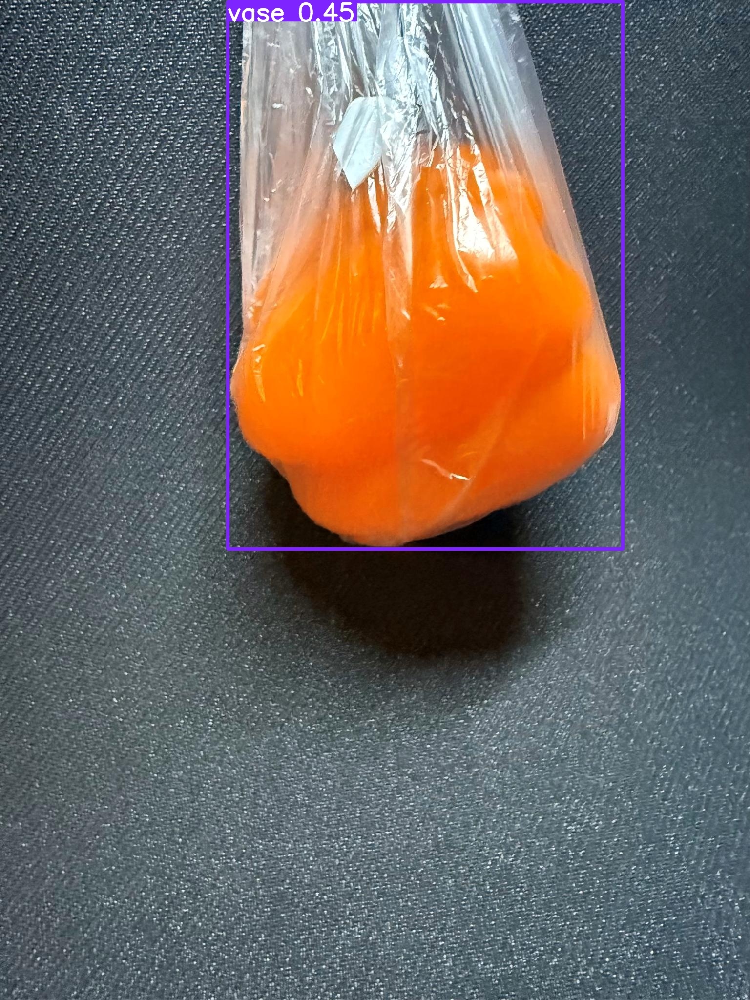

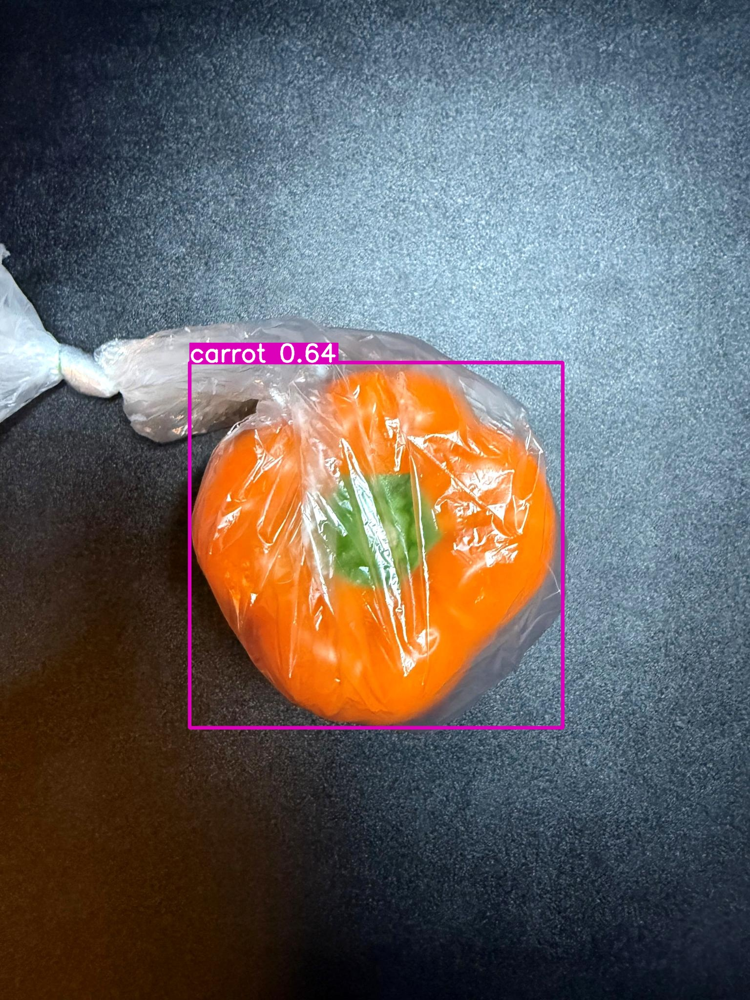

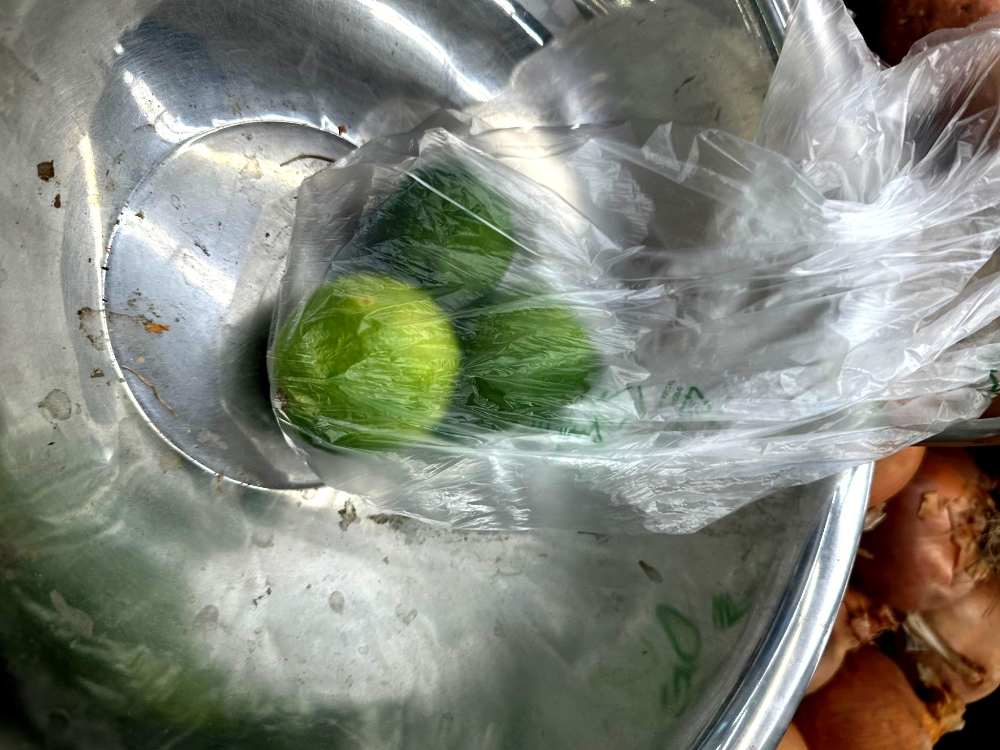

In [ ]:
from IPython.display import Image, display
import os
test_img_run = "/content/runs/detect/roboflow_dataset_yolov8s_pre-train_predictions"
# Get all files in test image directory
tested_images = [f for f in os.listdir(test_img_run)]
count = 0
for img in tested_images:
  display(Image(filename=os.path.join(test_img_run, img)))
  if count > 10:
    break

Fine tune yolov8s on the manually labeled dataset

In [ ]:
# Train
!yolo train \
  data="/content/roboflow_dataset/data.yaml" \
  model=yolov8s.pt \
  epochs=50 \
  batch=64 \
  workers=4 \
  imgsz=640 \
  device=0 \
  name="roboflow_dataset_yolov8s_train"

Ultralytics 8.3.111 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/roboflow_dataset/data.yaml, epochs=50, time=None, patience=100, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=4, project=None, name=roboflow_dataset_yolov8s_train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tr

Visualize training results

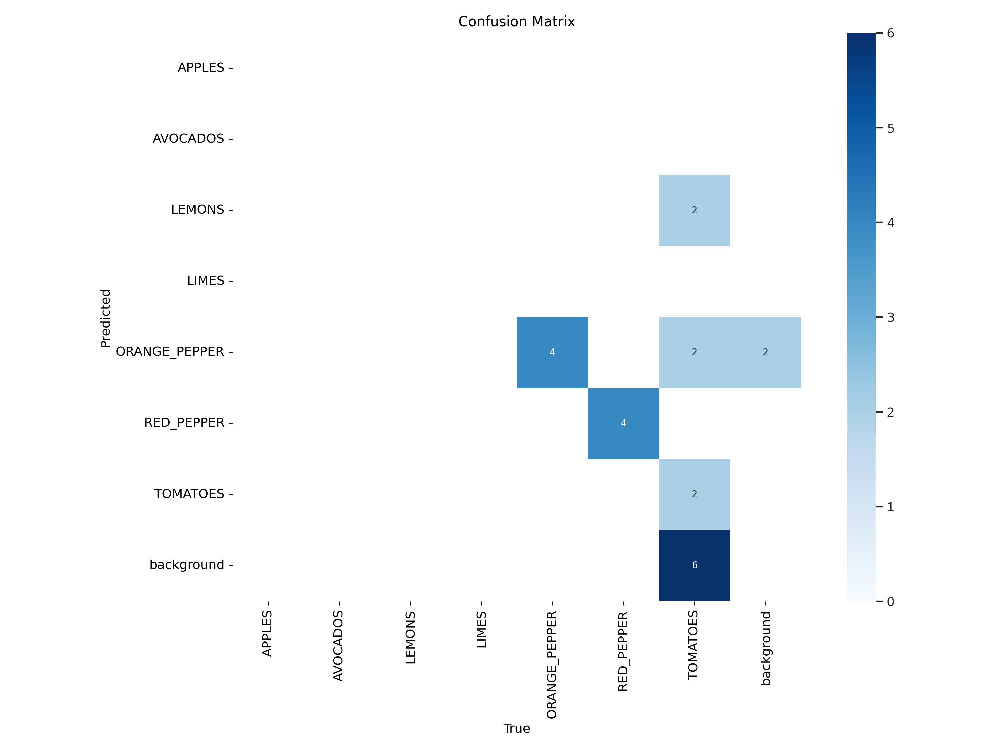

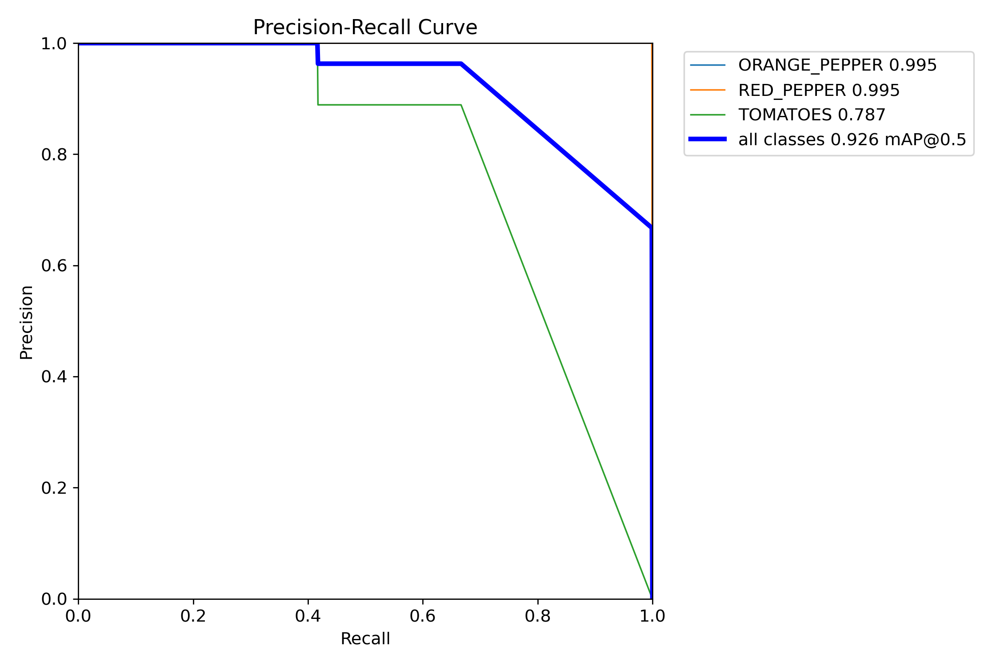

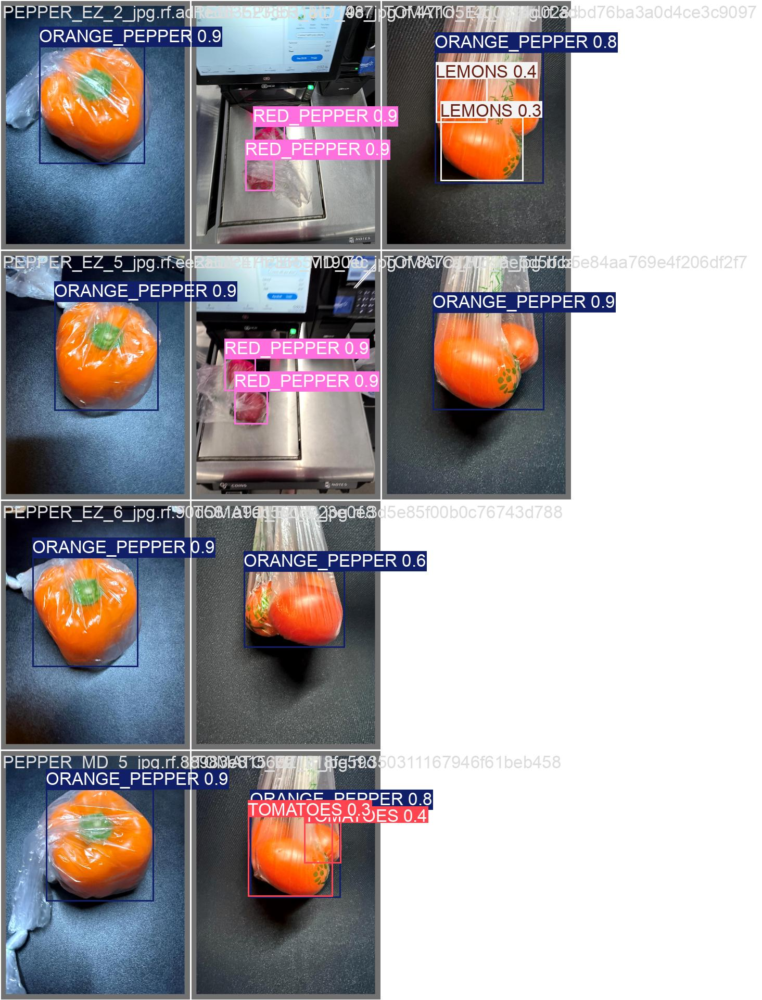

In [ ]:
from IPython.display import Image, display
import os

train_run_dir = "/content/runs/detect/roboflow_dataset_yolov8s_train"

confusion_matrix_path = os.path.join(train_run_dir, "confusion_matrix.png")
display(Image(filename=confusion_matrix_path, width=600))

pr_curve_path = os.path.join(train_run_dir, "PR_curve.png")
display(Image(filename=pr_curve_path, width=600))

val_pred_path = os.path.join(train_run_dir, "val_batch0_pred.jpg")

display(Image(filename=val_pred_path))

Evaluate fine-tuned model on testing set

In [ ]:
# Load best weights
model_weights = "/content/runs/detect/roboflow_dataset_yolov8s_train/weights/best.pt"

# Test images
test_images = "/content/roboflow_dataset/test/images"

# Evaluate on test images
!yolo predict \
  model="{model_weights}" \
  source="{test_images}" \
  save=True \
  device=0 \
  name="roboflow_dataset_yolov8s_test_predictions"
  # conf=0.4 # Conf threshold


Ultralytics 8.3.111 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (NVIDIA L4, 22693MiB)
Model summary (fused): 72 layers, 11,128,293 parameters, 0 gradients, 28.5 GFLOPs

image 1/10 /content/roboflow_dataset/test/images/LIME_SILVER_EZ_2_jpg.rf.ceef3940a23cc00aa302ce75a08015d9.jpg: 480x640 2 LIMESs, 62.4ms
image 2/10 /content/roboflow_dataset/test/images/LIME_SILVER_MD_9_jpg.rf.4360d6d8be9f0094227f2d2ec678c061.jpg: 480x640 3 AVOCADOSs, 1 LIMES, 7.7ms
image 3/10 /content/roboflow_dataset/test/images/PEPPER_EZ_1_jpg.rf.13e1109dff6f9c4b7fae62f044159cfc.jpg: 640x480 1 ORANGE_PEPPER, 68.9ms
image 4/10 /content/roboflow_dataset/test/images/PEPPER_MD_3_jpg.rf.0cdac8dc75baaa13a2cd0e12cc7f4eb8.jpg: 640x480 1 ORANGE_PEPPER, 8.5ms
image 5/10 /content/roboflow_dataset/test/images/PEPPER_MD_4_jpg.rf.70582bee17c81892de9998292534260b.jpg: 640x480 1 ORANGE_PEPPER, 8.0ms
image 6/10 /content/roboflow_dataset/test/images/PEPPER_MD_7_jpg.rf.c808bb88ef75f999a0fde990c77ca846.jpg: 640x480 1 ORANGE_PEPPER, 7.7ms
i

Visualize results

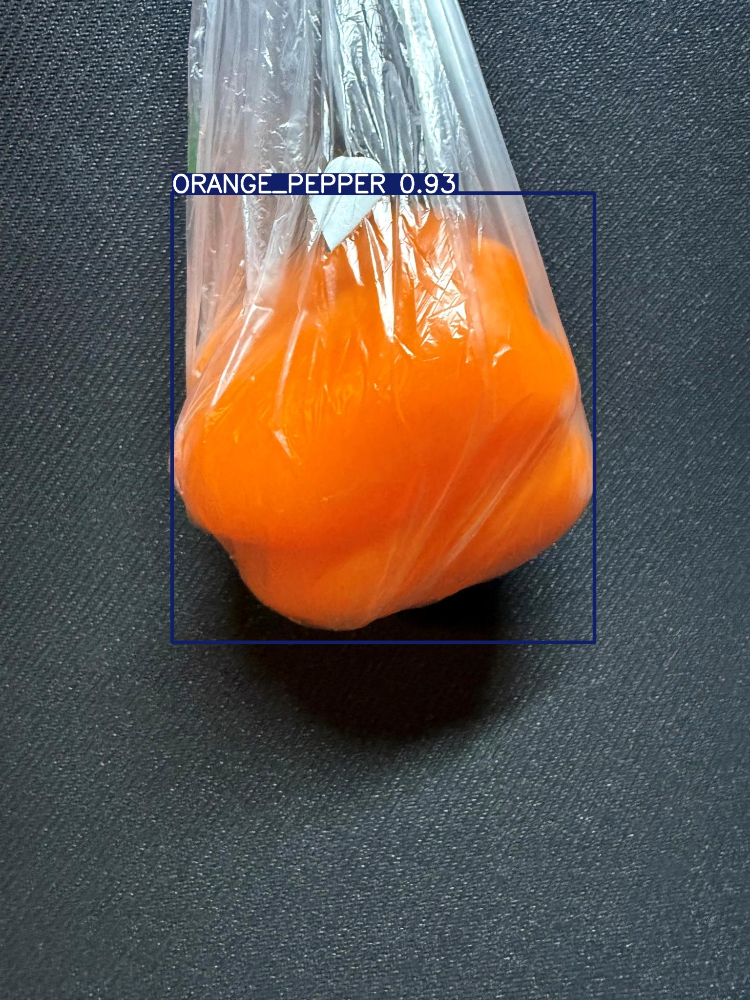

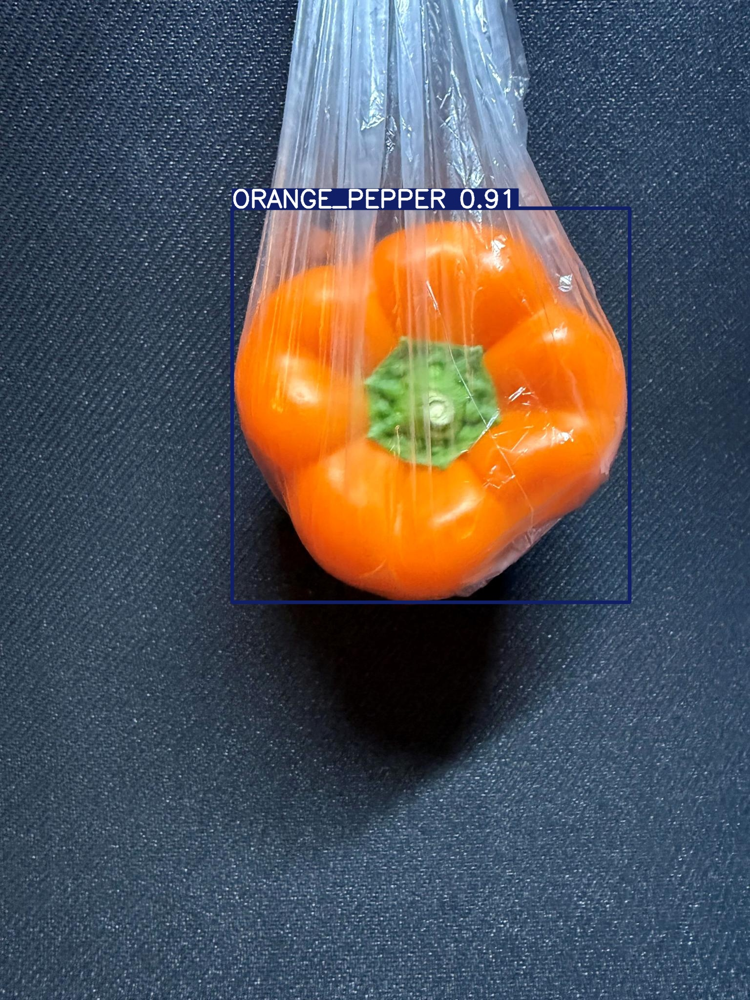

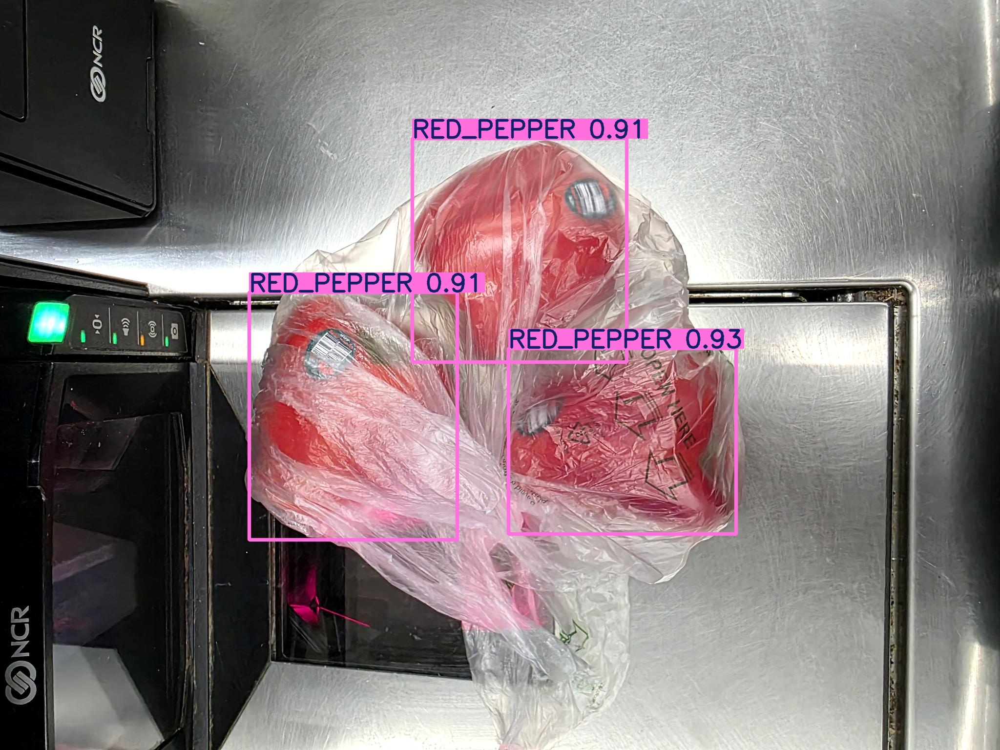

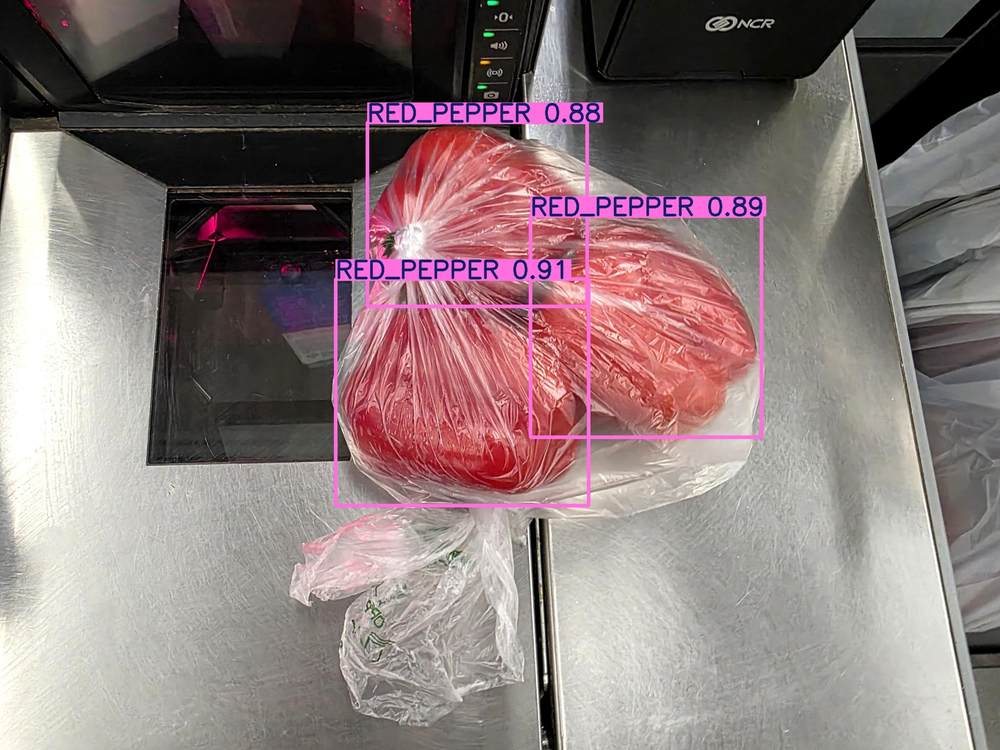

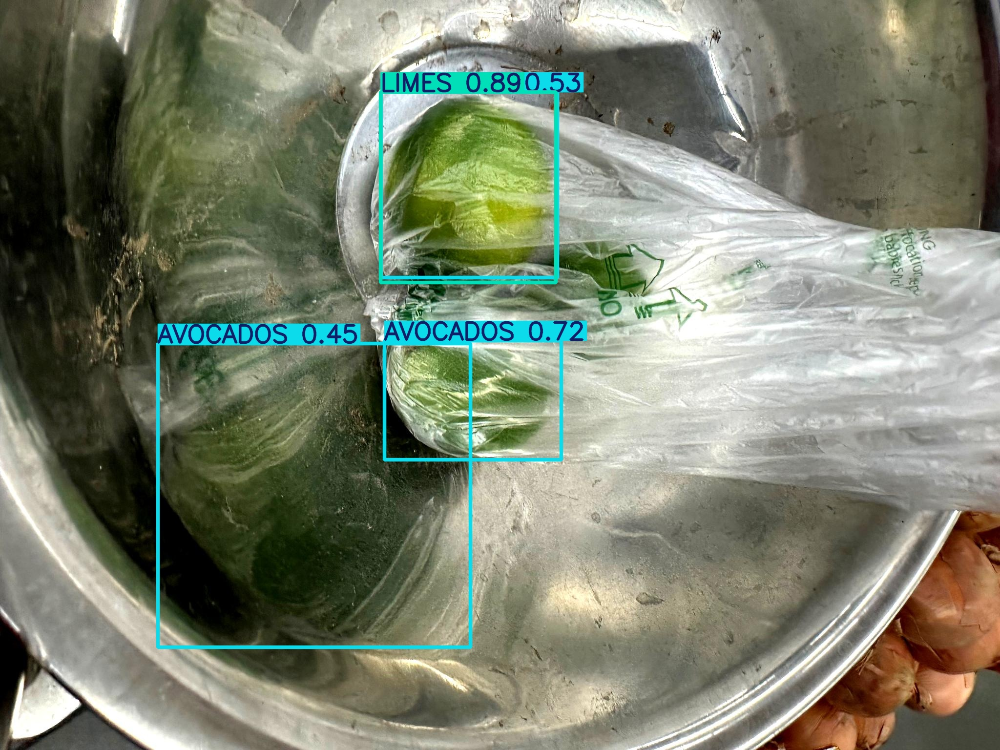

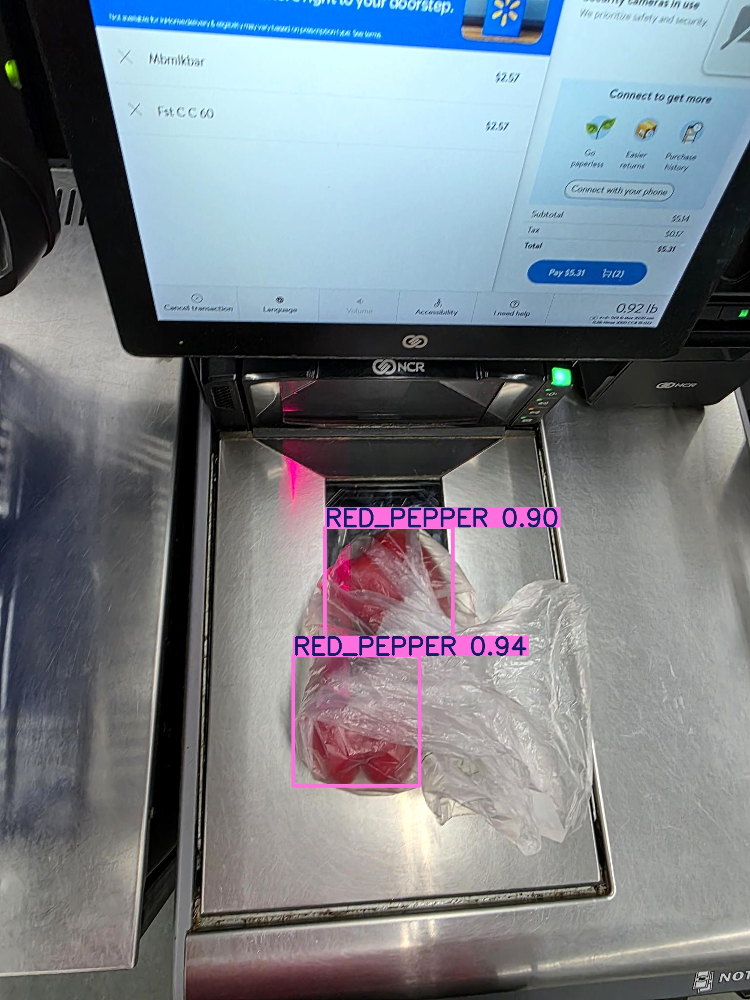

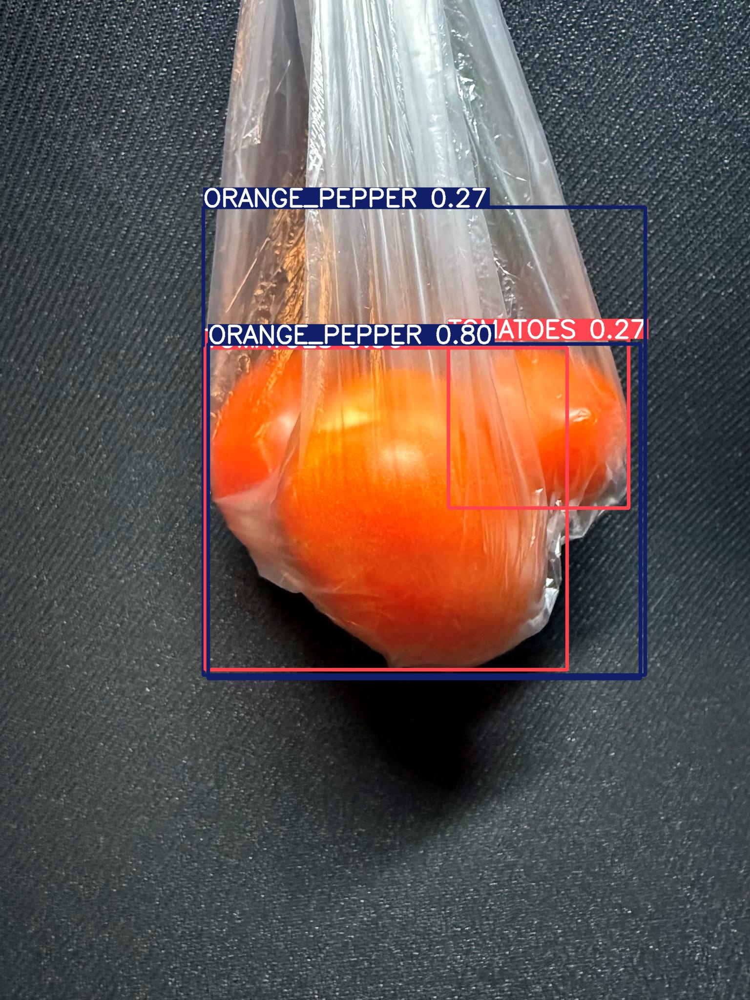

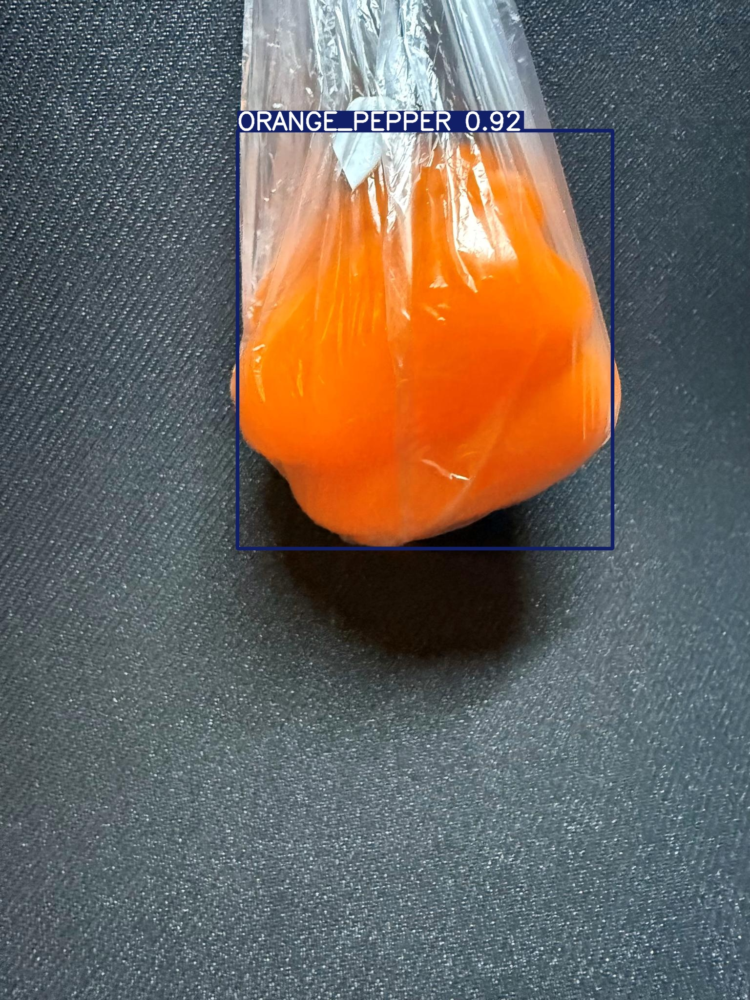

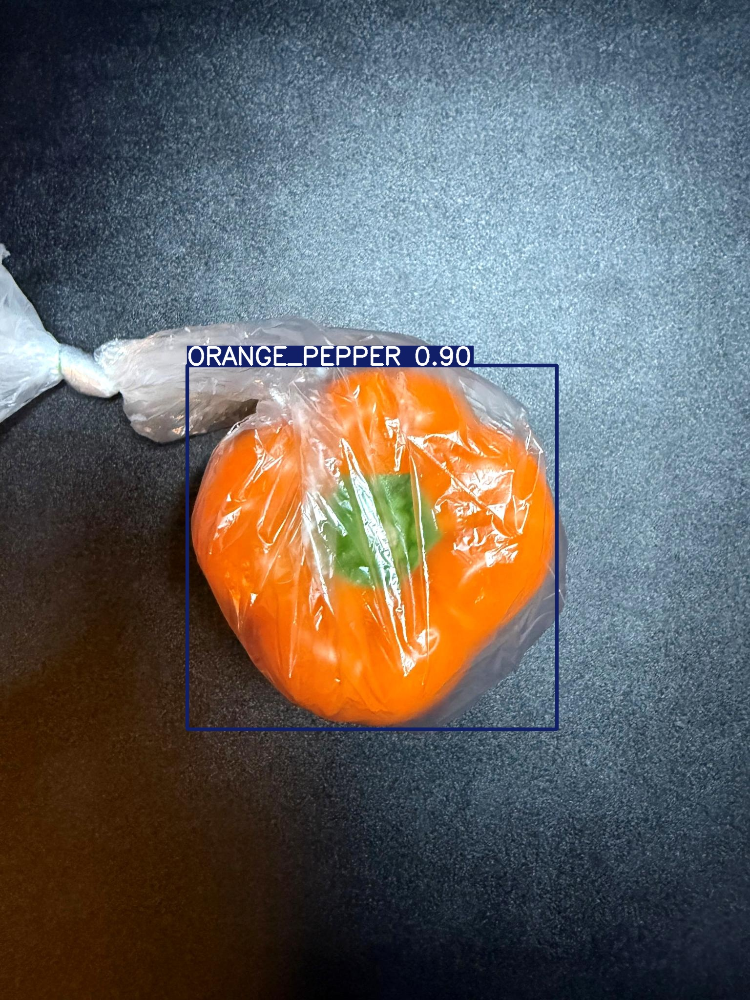

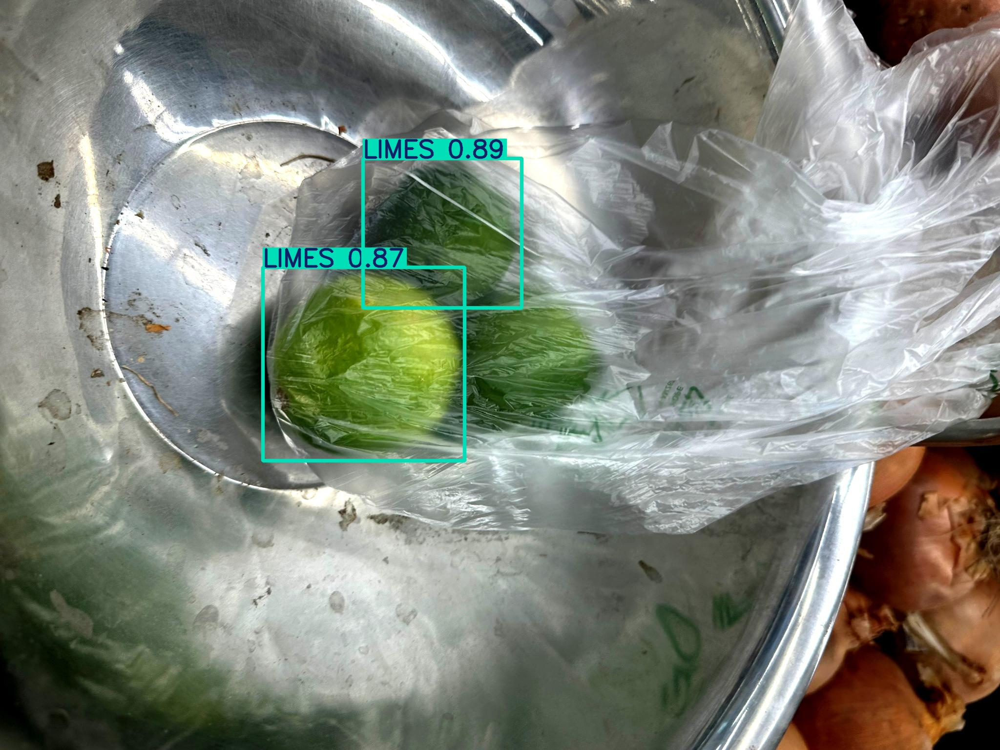

In [ ]:
test_img_run = "/content/runs/detect/roboflow_dataset_yolov8s_test_predictions"
# Get all files in test image directory
tested_images = [f for f in os.listdir(test_img_run)]
count = 0
for img in tested_images:
  count+=1
  display(Image(filename=os.path.join(test_img_run, img)))
  if count > 10:
    break

In [ ]:
!zip -r roboflow_yolov8s_model.zip "/content/runs/detect/roboflow_dataset_yolov8s_train"

from google.colab import files
files.download('roboflow_yolov8s_model.zip')

  adding: content/runs/detect/roboflow_dataset_yolov8s_train/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/P_curve.png (deflated 15%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/results.csv (deflated 61%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/labels_correlogram.jpg (deflated 41%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/PR_curve.png (deflated 17%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/labels.jpg (deflated 32%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/F1_curve.png (deflated 13%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/confusion_matrix.png (deflated 29%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/best.pt (deflated 8%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_train/weights/last.pt (deflated 8%)
  adding: content/runs/de

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!zip -r roboflow_yolov8s_test_predictions.zip "/content/runs/detect/roboflow_dataset_yolov8s_test_predictions"

files.download('roboflow_yolov8s_test_predictions.zip')

  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/ (stored 0%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/PEPPER_MD_4_jpg.rf.70582bee17c81892de9998292534260b.jpg (deflated 4%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/PEPPER_EZ_1_jpg.rf.13e1109dff6f9c4b7fae62f044159cfc.jpg (deflated 4%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/REDPEPPER_MD_115_jpg.rf.61752cc029c3448599b3f8244bced679.jpg (deflated 3%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/REDPEPPER_MD_113_jpg.rf.6030bd147cf18ca512a66e8ac836ea1d.jpg (deflated 3%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/LIME_SILVER_MD_9_jpg.rf.4360d6d8be9f0094227f2d2ec678c061.jpg (deflated 4%)
  adding: content/runs/detect/roboflow_dataset_yolov8s_test_predictions/REDPEPPER_MD_50_jpg.rf.d36c2c67805e0c8a2cfb054c6d8116a2.jpg (deflated 4%)
  adding: content/runs/detect/roboflow_datas

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>